# Voice conversion prototyping

with GMMs; VCTK corpus

Speakers p299 and p248

In [1]:
# open data
from os.path import join, expanduser
DATA_ROOT = join(expanduser("~"), "Documents/em_lct/UoM/thesis/data/", "VCTK-Corpus")
!ls $DATA_ROOT

COPYING          id-female        txt              wav48
README           speaker-info.txt us-female


In [2]:
# nnmnkwii imports taken from example notebook on VC
%pylab inline
rcParams["figure.figsize"] = (16,5)

from nnmnkwii.datasets import PaddedFileSourceDataset
from nnmnkwii.datasets.vctk import WavFileDataSource
from nnmnkwii.preprocessing.alignment import DTWAligner
from nnmnkwii.preprocessing import trim_zeros_frames, remove_zeros_frames, delta_features
from nnmnkwii.util import apply_each2d_trim
from nnmnkwii.metrics import melcd
from nnmnkwii.baseline.gmm import MLPG

from os import listdir
from os.path import basename, splitext, join, splitext, isdir
import sys
import time

import numpy as np
import pandas as pd
from scipy.io import wavfile
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import pyworld
import pysptk
from pysptk.synthesis import MLSADF, Synthesizer
import librosa
import librosa.display
import IPython
from IPython.display import Audio

Populating the interactive namespace from numpy and matplotlib


In [3]:
fs = 48000
fftlen = pyworld.get_cheaptrick_fft_size(fs)
alpha = pysptk.util.mcepalpha(fs)
order = 24
frame_period = 5
hop_length = int(fs * (frame_period * 0.001))
max_files = 23 # number of utterances to be used.
test_size = 0.4
use_delta = True

if use_delta:
    windows = [
        (0, 0, np.array([1.0])),
        (1, 1, np.array([-0.5, 0.0, 0.5])),
        (1, 1, np.array([1.0, -2.0, 1.0])),
    ]
else:
    windows = [
        (0, 0, np.array([1.0])),
    ]

In [4]:
class MyFileDataSource(WavFileDataSource):
    def __init__(self, *args, **kwargs):
        super(MyFileDataSource, self).__init__(*args, **kwargs)
        self.test_paths = None

    def collect_files(self):
        paths = super(
            MyFileDataSource, self).collect_files()
        paths_train, paths_test = train_test_split(
            paths, test_size=test_size, random_state=False)

        # keep paths for later testing
        self.test_paths = paths_test

        return paths_train

    def collect_features(self, path):
        fs, x = wavfile.read(path)
        x = x.astype(np.float64)
        f0, timeaxis = pyworld.dio(x, fs, frame_period=frame_period)
        f0 = pyworld.stonemask(x, f0, timeaxis, fs)
        spectrogram = pyworld.cheaptrick(x, f0, timeaxis, fs)
        spectrogram = trim_zeros_frames(spectrogram)
        mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
        return mc

In [5]:
src_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["248"], max_files=23)
tgt_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["299"], max_files=23)

In [6]:
# convert training sets into arrays
X = PaddedFileSourceDataset(src_speaker, 2800).asarray()
Y = PaddedFileSourceDataset(tgt_speaker, 2800).asarray()
print(X.shape)
print(Y.shape) 
# shape = (13 training audios, 2800 frames, 25 features per frame)

(13, 2800, 25)
(13, 2800, 25)


In [7]:
src_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_012.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_011.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_022.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_015.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_021.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_002.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_014.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_023.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_017.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_009.wav']

In [8]:
tgt_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_012.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_011.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_022.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_015.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_021.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_002.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_014.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_023.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_017.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_009.wav']

In [9]:
# Plotting util
def plot_parallel(x,y):
    figure(figsize=(16,7))
    subplot(2,1,1)
    librosa.display.specshow(trim_zeros_frames(x).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()
    subplot(2,1,2)
    librosa.display.specshow(trim_zeros_frames(y).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()

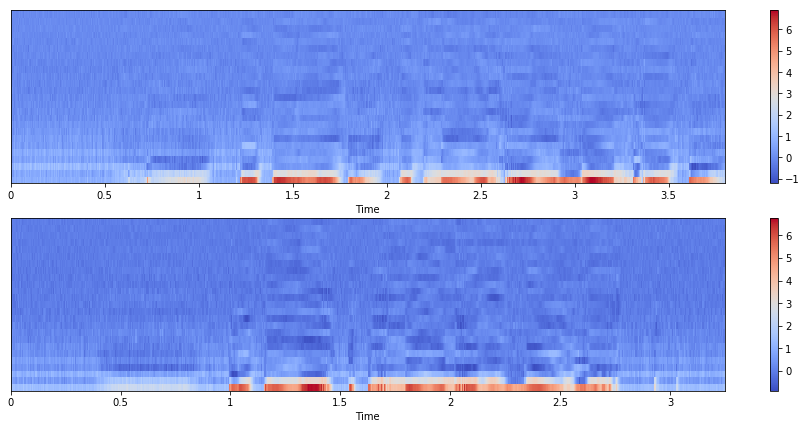

In [10]:
idx = 6 # any 
plot_parallel(X[idx],Y[idx])

In [11]:
# Alignment
X_aligned, Y_aligned = DTWAligner(verbose=0, dist=melcd).transform((X, Y))

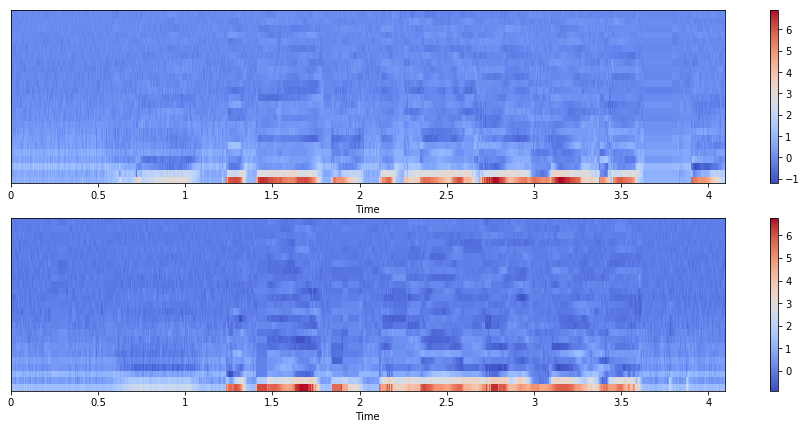

In [12]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

In [13]:
# Drop 1st (power) dimension
X_aligned, Y_aligned = X_aligned[:, :, 1:], Y_aligned[:, :, 1:]

In [14]:
static_dim = X_aligned.shape[-1]
if use_delta:
    X_aligned = apply_each2d_trim(delta_features, X_aligned, windows)
    Y_aligned = apply_each2d_trim(delta_features, Y_aligned, windows)

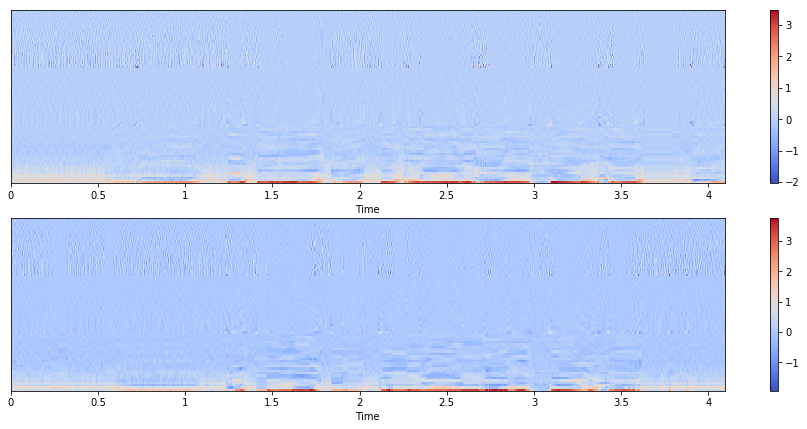

In [15]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

## Kmeans clustering of MFCC feature vectors

In [16]:
km_X = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [17]:
X_aligned.shape

(13, 2800, 72)

In [18]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_X = numpy.concatenate(X_aligned, axis=0)

In [19]:
# should equal number of frames * number of utterances
len(all_frames_X)

36400

In [20]:
all_frames_X.shape

(36400, 72)

In [21]:
all_frames_X[0]

array([ 1.32934749e+00,  6.12864256e-01,  4.30788308e-01,  3.18992674e-01,
        1.96561530e-01,  3.49595487e-01,  7.09880665e-02,  1.50685817e-01,
        1.04311369e-01,  1.49162719e-02,  2.89799664e-02, -1.24588601e-01,
        2.57975515e-02,  2.53006052e-02, -8.17913860e-02,  4.86140549e-02,
       -1.05500855e-01,  2.59937346e-02, -9.40926820e-02,  2.04902305e-03,
        2.83005293e-02, -6.48610219e-02,  3.43461893e-02, -2.98230313e-02,
        4.00513619e-01,  5.56958616e-01,  3.46411735e-01,  6.09467208e-01,
        2.97354132e-01,  1.99828327e-01,  1.53157517e-01,  7.64541626e-02,
       -3.92956063e-02,  6.43096194e-02,  8.62215832e-02, -1.69758510e-03,
       -7.22966716e-02, -2.25005969e-02, -5.58842160e-02, -3.97287644e-02,
       -3.40805016e-02, -6.25798181e-02, -3.31019461e-02, -3.31289507e-02,
        2.41959300e-02,  2.17675488e-03, -8.04520398e-03, -1.09385811e-02,
       -1.85766768e+00, -1.11811280e-01, -1.68753147e-01,  5.80949068e-01,
        2.01585203e-01, -

In [22]:
# 0 frames are removed since they are all exactly the same
all_frames_X = remove_zeros_frames(all_frames_X)

In [23]:
len(all_frames_X)

19544

In [24]:
%time
km_X.fit(all_frames_X)

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 6.91 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [25]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_X = pd.DataFrame()
clustered_X['frame'] = all_frames_X.tolist()
clustered_X['cluster #'] = km_X.labels_

In [26]:
clustered_X.head()

,frame,cluster #
0,"[1.3293474912643433, 0.6128642559051514, 0.430...",80
1,"[0.801027238368988, 1.1139172315597534, 0.6928...",252
2,"[0.6510758996009827, 1.093887448310852, 0.7020...",446
3,"[0.6931142807006836, 1.2244385480880737, 0.357...",317
4,"[0.8790184259414673, 1.1366856098175049, 0.543...",7


In [27]:
cluster_dist_X = clustered_X.groupby('cluster #').size()

In [28]:
# use print(cluster_dist_X.to_string()) to see whole dist
print (cluster_dist_X.head)

<bound method NDFrame.head of cluster #
0       11
1       16
2       83
3       32
4       54
5       79
6       11
7       56
8       25
9       90
10      41
11      25
12      68
13      18
14      31
15      77
16      88
17      43
18      48
19      61
20      29
21      10
22      81
23     110
24      35
25      79
26      25
27      92
28      55
29      45
      ... 
482     65
483     94
484     33
485      1
486     13
487     43
488     56
489     19
490     32
491     77
492     18
493     39
494     89
495     12
496     62
497     28
498      4
499     56
500     29
501     47
502     63
503      6
504     16
505     47
506     32
507     13
508     48
509      2
510     54
511     60
Length: 512, dtype: int64>


In [29]:
cluster_dist_X.describe()

count    512.000000
mean      38.171875
std       24.846569
min        1.000000
25%       20.000000
50%       36.000000
75%       51.000000
max      173.000000
dtype: float64

### Clustering of the target speaker data

In [30]:
km_Y = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [31]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_Y = numpy.concatenate(Y_aligned, axis=0)

In [32]:
# should equal number of frames * number of utterances
len(all_frames_Y)

36400

In [33]:
all_frames_Y.shape

(36400, 72)

In [34]:
test = all_frames_Y[0]

In [35]:
# 0 frames are removed since they are all exactly the same
all_frames_Y = remove_zeros_frames(all_frames_Y)

In [36]:
%time
km_Y.fit(all_frames_Y)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.91 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [37]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_Y = pd.DataFrame()
clustered_Y['frame'] = all_frames_Y.tolist()
clustered_Y['cluster #'] = km_Y.labels_

In [38]:
clustered_Y.head()

,frame,cluster #
0,"[1.0309396982192993, 0.6461661458015442, 0.252...",138
1,"[0.4956597089767456, 1.1655774116516113, 0.804...",267
2,"[0.4844866991043091, 0.9188348650932312, 0.397...",164
3,"[0.4366951882839203, 0.9900461435317993, 0.042...",310
4,"[0.6139588356018066, 1.013366937637329, 0.5878...",400


In [39]:
cluster_dist_Y = clustered_Y.groupby('cluster #').size()

In [40]:
# use print(cluster_dist_Y.to_string()) to see whole dist
print (cluster_dist_Y.head)

<bound method NDFrame.head of cluster #
0       68
1       25
2       12
3       38
4       56
5      156
6       41
7       38
8      123
9       45
10      47
11      18
12      34
13      24
14      39
15      13
16      56
17      52
18       7
19       9
20      24
21      44
22      69
23      59
24      37
25      59
26      62
27      44
28      35
29      48
      ... 
482      6
483     19
484     25
485     18
486     11
487     82
488      1
489     61
490     60
491     50
492     19
493     21
494     24
495     29
496     55
497     37
498     20
499      3
500     63
501     24
502     30
503      3
504     39
505     14
506     23
507      8
508     49
509     37
510     31
511     24
Length: 512, dtype: int64>


In [41]:
cluster_dist_Y.describe()

count    512.000000
mean      38.171875
std       28.626035
min        1.000000
25%       21.000000
50%       34.500000
75%       50.000000
max      256.000000
dtype: float64

### Building the look-up table

In [42]:
%time
# shape = (13 training audios, 2800 frames, 25 features per frame)
# if using array as key doesn't work, use the string representation
# and convert the array into a string when looking it up in the dictionary


# all_frames_x contains each frame from each audio inside of X (aka X_aligned)

# the psuedocode for finding closest frames 
# for frame in all_frames_X:
#    predict the cluster of the frame in clustered_Y
#    find the closest data point in clustered_Y to frame
#    store X_frame and most similar frame, Y_frame in paired_frames_X

from scipy import spatial

# bytes version of X: array from Y
paired_frames_X = {}

for frame in all_frames_X:
    # needs to be reshaped to shape of km training data 
    frame_pred = frame.reshape(1, -1)
    predicted_cluster = km_Y.predict(frame_pred)[0] # returns cluster num
    # grabs the possible frames and converts them to the proper array format for KDTree
    possible_frames = (clustered_Y[clustered_Y['cluster #'] == predicted_cluster]['frame'].values).tolist()
    tree = spatial.KDTree(possible_frames)
    # tree.query() returns (the distance between the closest frame and index in series)
    most_similar = tree.query(frame)
    most_similar_vec = np.array(possible_frames[most_similar[1]]) # index in possible_frames
    frame_key = frame.tobytes() # converted to bytes since arrays cannot be keys
    paired_frames_X[frame_key] = most_similar_vec  

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 8.11 µs


In [43]:
# creates the 'most similar to X' array
Y = np.array([paired_frames_X[frame.tobytes()] for frame in all_frames_X])

In [44]:
XY = np.concatenate((all_frames_X, Y), axis=-1)
print(XY.shape)

(19544, 144)


## GMM training

In [45]:
gmm = GaussianMixture(
    n_components=64, covariance_type="full", max_iter=100, verbose=1)

%time gmm.fit(XY)

Initialization 0
  Iteration 0
  Iteration 10
  Iteration 20
Initialization converged: True
CPU times: user 4min 36s, sys: 28.3 s, total: 5min 4s
Wall time: 2min 38s


GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=64, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=1,
        verbose_interval=10, warm_start=False, weights_init=None)

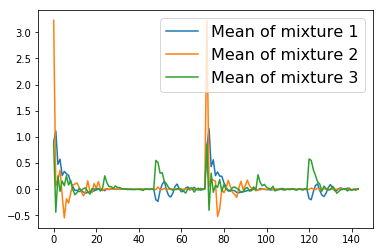

In [46]:
for k in range(3):
    plot(gmm.means_[k], linewidth=1.5, label="Mean of mixture {}".format(k+1))
legend(prop={"size": 16})

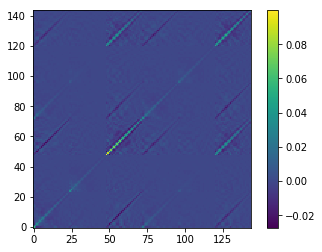

In [47]:
imshow(gmm.covariances_[0], origin="bottom left")
colorbar()

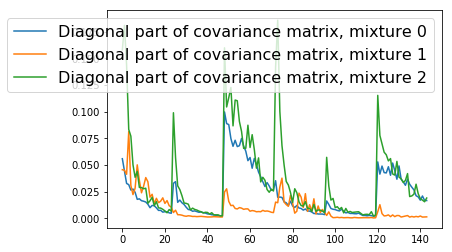

In [48]:
for k in range(3):
    plot(np.diag(gmm.covariances_[k]), linewidth=1.5, 
         label="Diagonal part of covariance matrix, mixture {}".format(k))
legend(prop={"size": 16})

In [49]:
def test_one_utt(src_path, tgt_path, disable_mlpg=False, diffvc=True):
    # GMM-based parameter generation is provided by the library in `baseline` module
    if disable_mlpg:
        # Force disable MLPG
        paramgen = MLPG(gmm, windows=[(0,0, np.array([1.0]))], diff=diffvc)
    else:
        paramgen = MLPG(gmm, windows=windows, diff=diffvc)

    fs, x = wavfile.read(src_path)
    x = x.astype(np.float64)
    f0, timeaxis = pyworld.dio(x, fs, frame_period=frame_period)
    f0 = pyworld.stonemask(x, f0, timeaxis, fs)
    spectrogram = pyworld.cheaptrick(x, f0, timeaxis, fs)
    aperiodicity = pyworld.d4c(x, f0, timeaxis, fs)

    mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
    c0, mc = mc[:, 0], mc[:, 1:]
    if use_delta:
        mc = delta_features(mc, windows)
    mc = paramgen.transform(mc)
    if disable_mlpg and mc.shape[-1] != static_dim:
        mc = mc[:,:static_dim]
    assert mc.shape[-1] == static_dim
    mc = np.hstack((c0[:, None], mc))
    if diffvc:
        mc[:, 0] = 0 # remove power coefficients
        engine = Synthesizer(MLSADF(order=order, alpha=alpha), hopsize=hop_length)
        b = pysptk.mc2b(mc.astype(np.float64), alpha=alpha)
        waveform = engine.synthesis(x, b)
    else:
        spectrogram = pysptk.mc2sp(
            mc.astype(np.float64), alpha=alpha, fftlen=fftlen)
        waveform = pyworld.synthesize(
            f0, spectrogram, aperiodicity, fs, frame_period)
        
    return waveform

In [50]:
for i, (src_path, tgt_path) in enumerate(zip(src_speaker.test_paths, tgt_speaker.test_paths)):
    print("{}-th sample".format(i+1))
    wo_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=True)
    w_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=False)
    _, src = wavfile.read(src_path)
    _, tgt = wavfile.read(tgt_path)
    
    print("Source:", basename(src_path))
    IPython.display.display(Audio(src, rate=fs))
    print("Target:", basename(tgt_path))
    IPython.display.display(Audio(tgt, rate=fs))
    print("w/o MLPG")
    IPython.display.display(Audio(wo_MLPG, rate=fs))
    print("w/ MLPG")
    IPython.display.display(Audio(w_MLPG, rate=fs))

1-th sample
Source: p248_012.wav


Target: p299_012.wav


w/o MLPG


w/ MLPG


2-th sample
Source: p248_011.wav


Target: p299_011.wav


w/o MLPG


w/ MLPG


3-th sample
Source: p248_022.wav


Target: p299_022.wav


w/o MLPG


w/ MLPG


4-th sample
Source: p248_015.wav


Target: p299_015.wav


w/o MLPG


w/ MLPG


5-th sample
Source: p248_021.wav


Target: p299_021.wav


w/o MLPG


w/ MLPG


6-th sample
Source: p248_002.wav


Target: p299_002.wav


w/o MLPG


w/ MLPG


7-th sample
Source: p248_014.wav


Target: p299_014.wav


w/o MLPG


w/ MLPG


8-th sample
Source: p248_023.wav


Target: p299_023.wav


w/o MLPG


w/ MLPG


9-th sample
Source: p248_017.wav


Target: p299_017.wav


w/o MLPG


w/ MLPG


10-th sample
Source: p248_009.wav


Target: p299_009.wav


w/o MLPG


w/ MLPG
